In [1]:
import pandas as pd
import plotly.express as px
import numpy as np
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [35]:
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
train = pd.read_csv('train_features.csv')
test = pd.read_csv('test_features.csv')

train['dataset'] = 'train'
test['dataset'] = 'test'

df = pd.concat([train, test])

In [3]:
cp_width = 500
cp_height = 400
scatter_size = 600

In [4]:
train.head(3)

,sig_id,cp_type,cp_time,cp_dose,g-0,g-1,g-2,g-3,g-4,g-5,...,c-91,c-92,c-93,c-94,c-95,c-96,c-97,c-98,c-99,dataset
0,id_000644bb2,trt_cp,24,D1,1.0620,0.5577,-0.2479,-0.6208,-0.1944,-1.0120,...,0.2584,0.8076,0.5523,-0.1912,0.6584,-0.3981,0.2139,0.3801,0.4176,train
1,id_000779bfc,trt_cp,72,D1,0.0743,0.4087,0.2991,0.0604,1.0190,0.5207,...,0.7543,0.4708,0.0230,0.2957,0.4899,0.1522,0.1241,0.6077,0.7371,train
2,id_000a6266a,trt_cp,48,D1,0.6280,0.5817,1.5540,-0.0764,-0.0323,1.2390,...,-0.6297,0.6103,0.0223,-1.3240,-0.3174,-0.6417,-0.2187,-1.4080,0.6931,train


In [5]:
test.head(3)

,sig_id,cp_type,cp_time,cp_dose,g-0,g-1,g-2,g-3,g-4,g-5,...,c-91,c-92,c-93,c-94,c-95,c-96,c-97,c-98,c-99,dataset
0,id_0004d9e33,trt_cp,24,D1,-0.5458,0.1306,-0.5135,0.4408,1.5500,-0.1644,...,0.7978,-0.143,-0.2067,-0.2303,-0.1193,0.0210,-0.0502,0.1510,-0.7750,test
1,id_001897cda,trt_cp,72,D1,-0.1829,0.2320,1.2080,-0.4522,-0.3652,-0.3319,...,-0.1852,-1.031,-1.3670,-0.3690,-0.5382,0.0359,-0.4764,-1.3810,-0.7300,test
2,id_002429b5b,ctl_vehicle,24,D1,0.1852,-0.1404,-0.3911,0.1310,-1.4380,0.2455,...,0.3370,-1.384,0.8604,-1.9530,-1.0140,0.8662,1.0160,0.4924,-0.1942,test


In [6]:
# Genes and Cells 
train_columns = train.columns.to_list()

g_list = [
    i for i in train_columns if i.startswith('g-')
]

c_list = [
    i for i in train_columns if i.startswith('c-')
]

In [7]:
# Function to plot our various histograms
def plot_set_histograms(plot_list, title):
    fig = make_subplots(rows=4, cols=3)
    traces = [
        go.Histogram(
            x=train[col], 
            nbinsx=100, 
            name=col
        ) for col in plot_list
    ]

    for i in range(len(traces)):
        fig.append_trace(
            traces[i], 
            (i // 3) + 1, 
            (i % 3) + 1
        )

    fig.update_layout(
        title_text=title,
        height=1000,
        width=800
    )
    fig.show()

In [8]:
plot_list = [
    g_list[
        np.random.randint(0, len(g_list)-1)
    ] for i in range(50)
]

plot_list = list(set(plot_list))[:12]
plot_set_histograms(plot_list, 'Randomly selected gene expression features distributions')

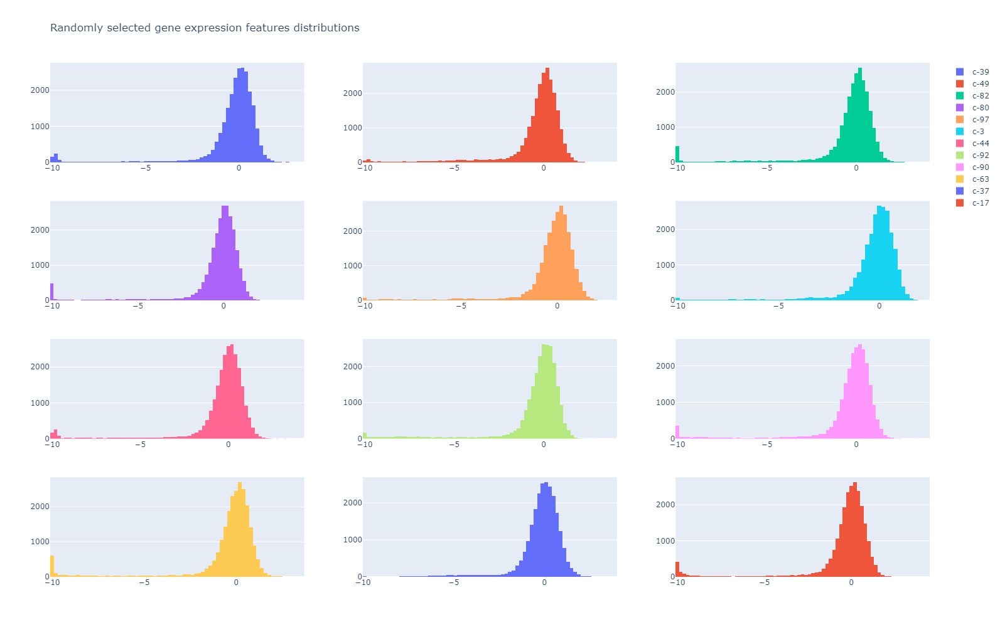

In [10]:
plot_list = [
    c_list[
        np.random.randint(0, len(c_list)-1)
    ] for i in range(50)
]

plot_list = list(set(plot_list))[:12]
plot_set_histograms(plot_list, 'Randomly selected gene expression features distributions')

In [9]:
train_target = pd.read_csv("train_targets_scored.csv")

print('Number of rows: ', train_target.shape[0])
print('Number of cols: ', train_target.shape[1])

train_target.head()

Number of rows:  23814
Number of cols:  207


,sig_id,5-alpha_reductase_inhibitor,11-beta-hsd1_inhibitor,acat_inhibitor,acetylcholine_receptor_agonist,acetylcholine_receptor_antagonist,acetylcholinesterase_inhibitor,adenosine_receptor_agonist,adenosine_receptor_antagonist,adenylyl_cyclase_activator,...,tropomyosin_receptor_kinase_inhibitor,trpv_agonist,trpv_antagonist,tubulin_inhibitor,tyrosine_kinase_inhibitor,ubiquitin_specific_protease_inhibitor,vegfr_inhibitor,vitamin_b,vitamin_d_receptor_agonist,wnt_inhibitor
0,id_000644bb2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,id_000779bfc,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,id_000a6266a,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,id_0015fd391,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,id_001626bd3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


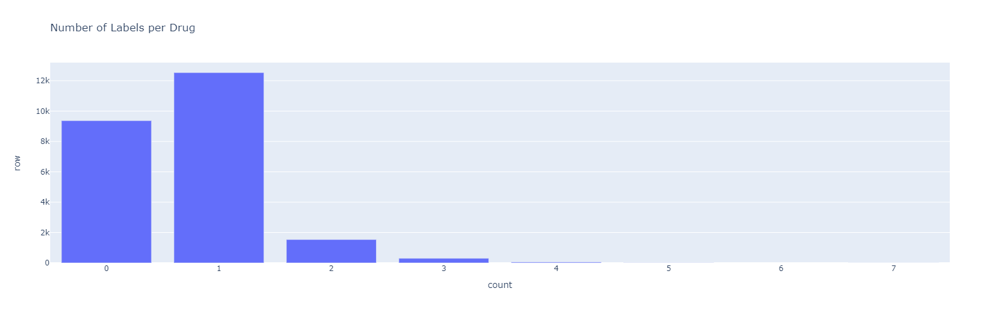

In [14]:
data = train_target.drop(['sig_id'], axis=1).astype(bool).sum(axis=1).reset_index()

data.columns = [
    'row', 
    'count'
]

data = data.groupby(['count'])['row'].count().reset_index()

fig = px.bar(
    data, 
    y=data['row'], 
    x="count", 
    title='Number of Labels per Drug', 
    width=800, 
    height=500
)
fig.show()

In [ ]:
data = train_target.drop(['sig_id'], axis=1).astype(bool).sum(axis=1).reset_index()

data.columns = [
    'row', 
    'count'
]

data = data.groupby(['count'])['row'].count().reset_index()

fig = px.bar(
    data, 
    y=data['row'], 
    x="count", 
    title='Number of Labels per Drug', 
    width=800, 
    height=500
)
fig.show()

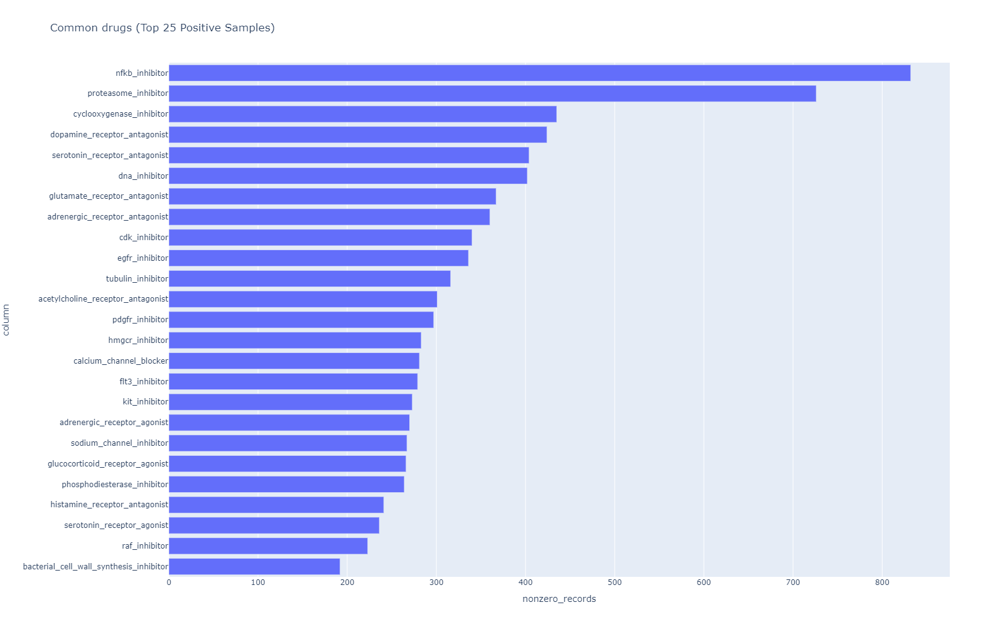

In [12]:
x = train_target.drop(['sig_id'], axis=1).sum(axis=0).sort_values().reset_index()
x.columns = [
    'column', 
    'nonzero_records'
]
x = x.tail(25)

fig = px.bar(
    x, 
    x='nonzero_records', 
    y='column', 
    orientation='h', 
    title='Common drugs (Top 25 Positive Samples)', 
    width=800,
    height=1000
)

fig.show()

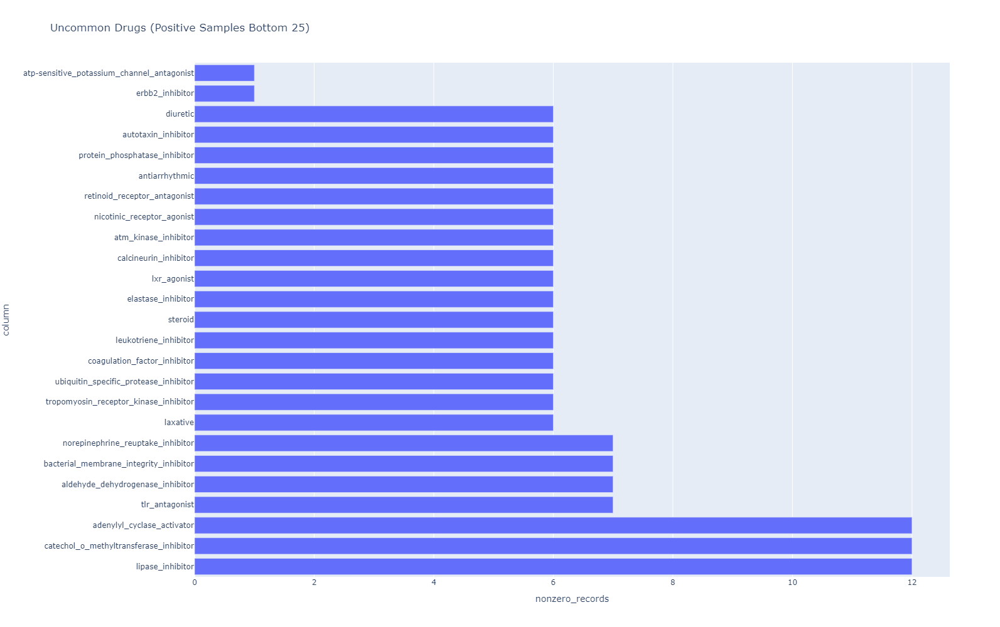

In [13]:
# All samples have been tested at least twice (once with low dose, and once with high dose)
x = train_target.drop(['sig_id'], axis=1).sum(axis=0).sort_values(ascending=False).reset_index()

x.columns = [
    'column', 
    'nonzero_records'
]

x = x.tail(25)

fig = px.bar(
    x, 
    x='nonzero_records', 
    y='column', 
    orientation='h', 
    title='Uncommon Drugs (Positive Samples Bottom 25)', 
    width=800,
    height=1000 
)

fig.show()

#### Certain drug classes are highly correlated with specific genetic pathways

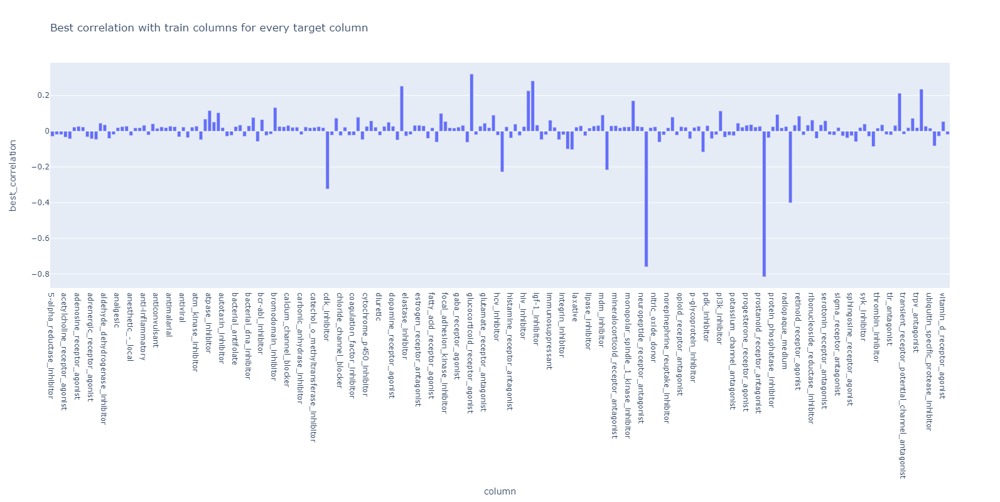

In [20]:
maxCol=lambda x: max(x.min(), x.max(), key=abs)

high_scores = correlation_matrix.apply(maxCol, axis=0).reset_index()
high_scores.columns = [
    'column', 
    'best_correlation'
]

fig = px.bar(
    high_scores, 
    x='column', 
    y="best_correlation", 
    orientation='v', 
    title='Best correlation with train columns for every target column', 
    width=1200,
    height=800
)

fig.show()

In [16]:
columns = g_list + c_list

In [17]:
correlation_matrix = pd.DataFrame()

for t_col in train_target.columns:
    corr_list = list()
    if t_col == 'sig_id':
        continue
    for col in columns:
        res = train[col].corr(train_target[t_col])
        corr_list.append(res)
    correlation_matrix[t_col] = corr_list

In [18]:
correlation_matrix['train_features'] = columns
correlation_matrix = correlation_matrix.set_index('train_features')

correlation_matrix

,5-alpha_reductase_inhibitor,11-beta-hsd1_inhibitor,acat_inhibitor,acetylcholine_receptor_agonist,acetylcholine_receptor_antagonist,acetylcholinesterase_inhibitor,adenosine_receptor_agonist,adenosine_receptor_antagonist,adenylyl_cyclase_activator,adrenergic_receptor_agonist,...,tropomyosin_receptor_kinase_inhibitor,trpv_agonist,trpv_antagonist,tubulin_inhibitor,tyrosine_kinase_inhibitor,ubiquitin_specific_protease_inhibitor,vegfr_inhibitor,vitamin_b,vitamin_d_receptor_agonist,wnt_inhibitor
train_features,,,,,,,,,,,,,,,,,,,,,
g-0,-0.008317,-0.011513,0.003049,-0.019100,-0.034001,-0.009239,-0.019205,-0.011048,-0.008982,-0.028803,...,-0.005502,-0.005343,-0.011480,-0.035796,-0.011603,-0.005810,0.008336,-0.006992,-0.004046,-0.006481
g-1,-0.004291,-0.004084,-0.000265,-0.005629,0.004920,0.009246,-0.003603,0.006332,-0.001601,0.012687,...,-0.005564,0.009758,0.000162,-0.003212,0.005468,-0.002795,-0.007093,-0.001118,-0.000202,0.000681
g-2,0.000719,-0.002585,-0.004516,-0.004385,-0.016947,0.002133,-0.002664,-0.009920,0.003295,-0.008364,...,0.006100,0.003845,0.007066,0.002302,0.012868,0.003467,0.000210,-0.002793,0.015729,0.002028
g-3,-0.008268,-0.002384,0.001146,-0.007750,-0.010446,-0.013589,-0.002952,-0.002539,0.006999,-0.012385,...,0.014440,-0.012509,-0.014529,-0.006532,-0.000278,-0.000885,0.003360,-0.001645,-0.005706,-0.001866
g-4,-0.003799,0.002661,0.006287,-0.010288,-0.010128,-0.009890,-0.007749,-0.003269,-0.004590,-0.006856,...,-0.000343,-0.000934,-0.008336,-0.022563,-0.002673,0.000025,-0.007507,0.002381,-0.000472,0.003345
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
c-95,0.010113,0.004202,0.003092,0.022601,0.029189,0.014921,0.016299,0.014628,0.001739,0.022537,...,0.004961,-0.003125,0.010209,-0.066567,-0.003060,0.003947,-0.014844,0.010449,0.009496,0.009497
c-96,0.008570,0.008131,0.010796,0.019768,0.029630,0.012617,0.012412,0.016469,0.006084,0.028096,...,0.002569,-0.000608,0.011297,-0.091944,0.007333,0.002410,0.000934,0.008592,0.014562,0.010589
c-97,0.009440,0.003168,0.009347,0.021624,0.026226,0.016902,0.013411,0.015404,-0.004710,0.027801,...,0.002164,-0.000334,0.010238,-0.121671,0.008242,-0.000108,0.012341,0.005864,0.006122,0.010069


In [21]:
col_df = pd.DataFrame()
tr_cols = list()
tar_cols = list()

for col in correlation_matrix.columns:
    tar_cols.append(col)
    tr_cols.append(
        correlation_matrix[col].abs().sort_values(ascending=False).reset_index()['train_features'].head(1).values[0]
    )

col_df['column'] = tar_cols
col_df['train_best_column'] = tr_cols

total_scores = pd.merge(high_scores, col_df)

total_scores

,column,best_correlation,train_best_column
0,5-alpha_reductase_inhibitor,-0.028704,g-211
1,11-beta-hsd1_inhibitor,-0.018517,g-571
2,acat_inhibitor,-0.018810,g-350
3,acetylcholine_receptor_agonist,-0.033727,g-91
4,acetylcholine_receptor_antagonist,-0.042654,g-392
...,...,...,...
201,ubiquitin_specific_protease_inhibitor,0.017409,g-18
202,vegfr_inhibitor,-0.082568,c-98
203,vitamin_b,-0.027648,g-356
204,vitamin_d_receptor_agonist,0.054114,g-627


### We also have certain genetic pathways which are highly correlated with multiple different classes of drugs (likely combinations of agonists and antagonists, and likely stuff like DNA inhibitors and NFKB inhibitors hitting the same pathways

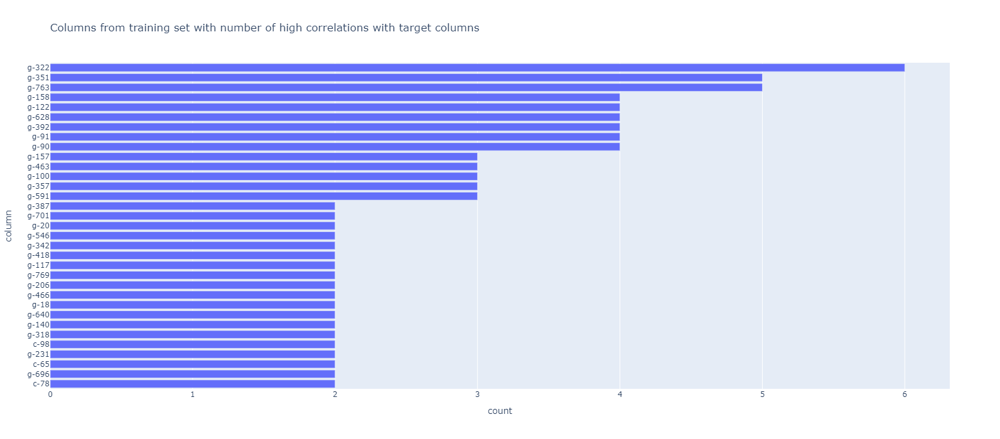

In [22]:
count_features = total_scores['train_best_column'].value_counts().reset_index().sort_values('train_best_column')
count_features.columns = [
    'column', 
    'count'
]
count_features = count_features.tail(33)

fig = px.bar(
    count_features, 
    x='count', 
    y="column", 
    orientation='h', 
    title='Columns from training set with number of high correlations with target columns', 
    width=800,
    height=700
)

fig.show()

In [29]:
target_columns = train_target.columns.tolist()
target_columns.remove('sig_id')
for_analysis = [
    target_columns[
        np.random.randint(0, len(target_columns)-1)
    ] for i in range(20)
]

current_corr = correlation_matrix[for_analysis]

In [30]:
col_df = pd.DataFrame()
tr_first_cols = list()
tr_second_cols = list()
tar_cols = list()

for col in current_corr.columns:
    tar_cols.append(col)
    tr_first_cols.append(
        current_corr[col].abs().sort_values(ascending=False).reset_index()['train_features'].head(2).values[0]
    )
    tr_second_cols.append(
        current_corr[col].abs().sort_values(ascending=False).reset_index()['train_features'].head(2).values[1]
    )

col_df['column'] = tar_cols
col_df['train_1_column'] = tr_first_cols
col_df['train_2_column'] = tr_second_cols

col_df

,column,train_1_column,train_2_column
0,autotaxin_inhibitor,g-706,g-362
1,estrogen_receptor_agonist,g-322,g-91
2,antifungal,g-200,g-524
3,angiogenesis_inhibitor,g-165,g-483
4,bacterial_30s_ribosomal_subunit_inhibitor,g-537,g-505
5,mtor_inhibitor,g-599,g-165
6,topoisomerase_inhibitor,g-90,g-135
7,serotonin_reuptake_inhibitor,g-324,g-94
8,smoothened_receptor_antagonist,g-205,g-191
9,cc_chemokine_receptor_antagonist,c-30,g-137


In [25]:
def plot_scatter(col_df, index):
    analysis = pd.DataFrame()
    analysis['color'] = train_target[col_df.iloc[index]['column']]
    analysis['x'] = train[col_df.iloc[index]['train_1_column']]
    analysis['y'] = train[col_df.iloc[index]['train_2_column']]
    analysis.columns = [
        'color', 
        col_df.iloc[index]['train_1_column'], 
        col_df.iloc[index]['train_2_column']
    ]
    analysis['size'] = 1
    analysis.loc[analysis['color'] == 1, 'size'] = 12

    fig = px.scatter(
        analysis, 
        x=col_df.iloc[index]['train_1_column'], 
        y=col_df.iloc[index]['train_2_column'], 
        color="color", 
        size='size', 
        width=scatter_size,
        height=scatter_size,
        title='Scatter plot for ' + col_df.iloc[index]['column']
    )
    fig.show()

### This looks visually a little something like this (for the two most correlated genes with opioid receptor antagonists for example)

### So even without labels for these genes (the dataset was released without labels for these genes and cells so a handcrafted answer could not be produced), we can take a pretty good guess at what they might be: for serotonin receptors, the transporter gene is SLC6A4, and 5-HTP is encoded for by HTR2A, so these two highly correlated genes are probably those two

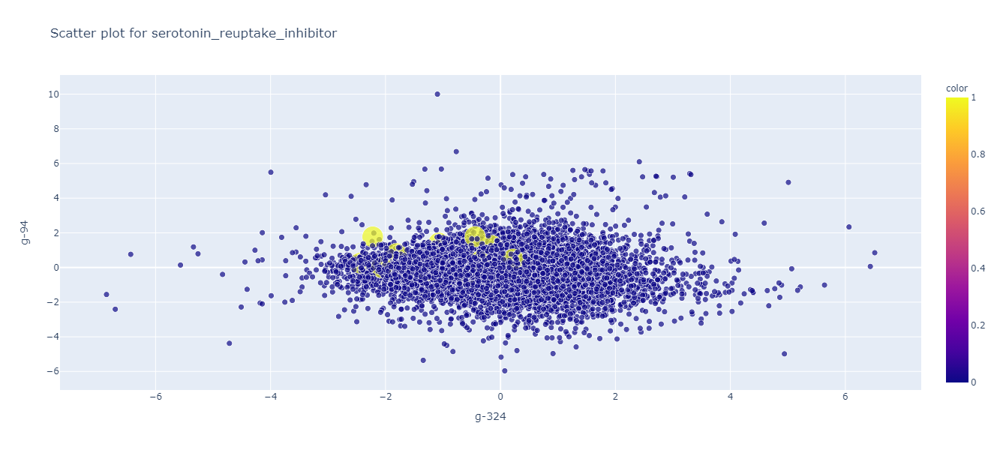

In [31]:
plot_scatter(col_df, 7)

### A general overview of the labels we're working with

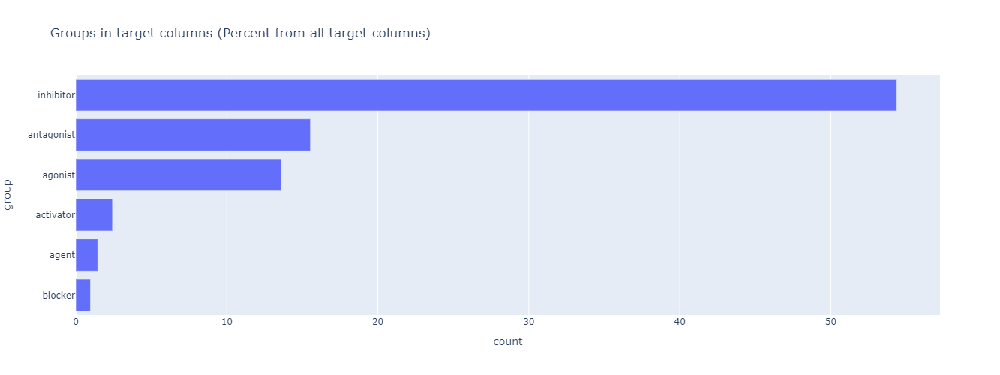

In [32]:
last_term = dict()

for item in target_columns:
    try:
        last_term[item.split('_')[-1]] += 1
    except:
        last_term[item.split('_')[-1]] = 1

last_term = pd.DataFrame(last_term.items(), columns=['group', 'count'])
last_term = last_term.sort_values('count')
last_term = last_term[last_term['count']>1]
last_term['count'] = last_term['count'] * 100 / 206

fig = px.bar(
    last_term, 
    x='count', 
    y="group", 
    orientation='h', 
    title='Groups in target columns (Percent from all target columns)', 
    width=800,
    height=500
)

fig.show()

### Inhibitors, antagonists, and blockers are basically the same thing generally speaking, as with agonists, activators, and agents, so we could technically make this a binary classification problem, and then build a further modeler based on what type of agonists / antagonists we're working with, but TabNet works so well that we're just going straight to multi-labeling

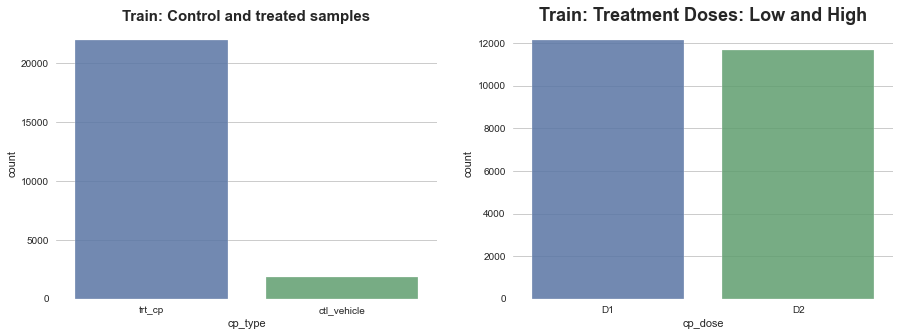

<Figure size 576x396 with 0 Axes>

In [37]:
plt.style.use('seaborn')
sns.set_style('whitegrid')
fig = plt.figure(figsize=(15,5))
#1 rows 2 cols
#first row, first col
ax1 = plt.subplot2grid((1,2),(0,0))
sns.countplot(x='cp_type', data=train, alpha=0.85)
plt.title('Train: Control and treated samples', fontsize=15, weight='bold')
#first row sec col
ax1 = plt.subplot2grid((1,2),(0,1))
sns.countplot(x='cp_dose', data=train, alpha=0.85)
plt.title('Train: Treatment Doses: Low and High',weight='bold', fontsize=18)
plt.show()
plt.savefig('control and treatment dose.png')

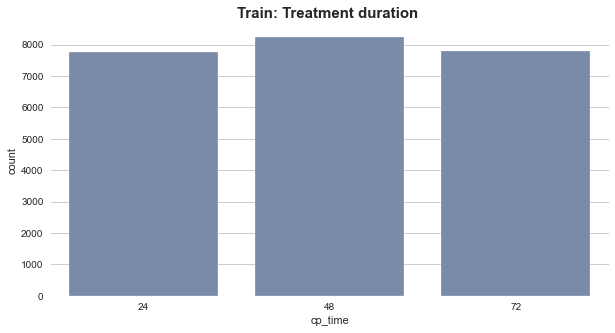

<Figure size 576x396 with 0 Axes>

In [38]:
plt.figure(figsize=(10,5))
sns.set_style('whitegrid')
sns.countplot( train['cp_time'], color='#7289B1')
plt.title("Train: Treatment duration ", fontsize=15, weight='bold')
plt.show()
plt.savefig('duration.png')

In [40]:
GENES = [g for g in train.columns if g.startswith("g-")]
print(f"Number of gene features: {len(GENES)}")
CELLS = [c for c in train.columns if c.startswith("c-")]
print(f"Number of cell features: {len(CELLS)}")

Number of gene features: 772
Number of cell features: 100


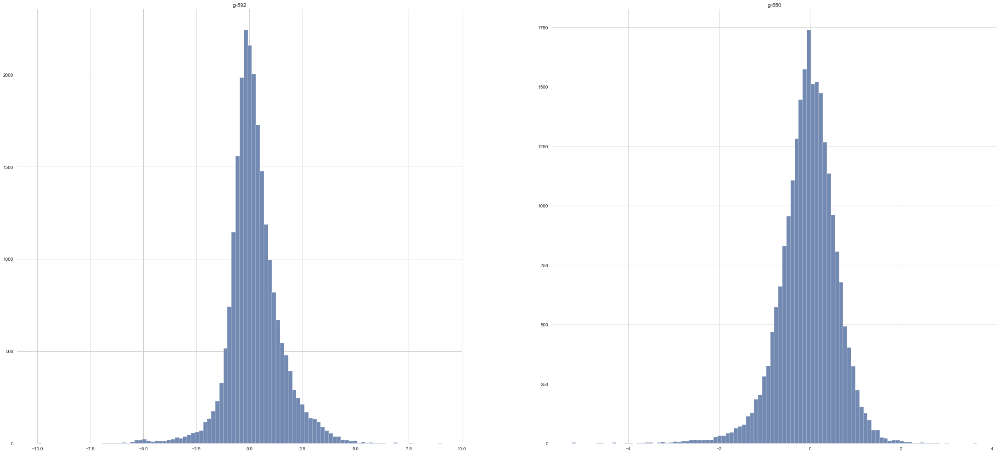

In [42]:
plt.figure(figsize=(80,80))
sns.set_style('whitegrid')
gene_choice=np.random.choice(len(GENES),2)
for i,col in enumerate(gene_choice):
    plt.subplot(4,4,i+1)
    plt.hist(train.loc[:,GENES[col]],bins=100,color='#7289B1')
    plt.title(GENES[col])
plt.savefig('random genedistro.png', bbox_inches='tight')

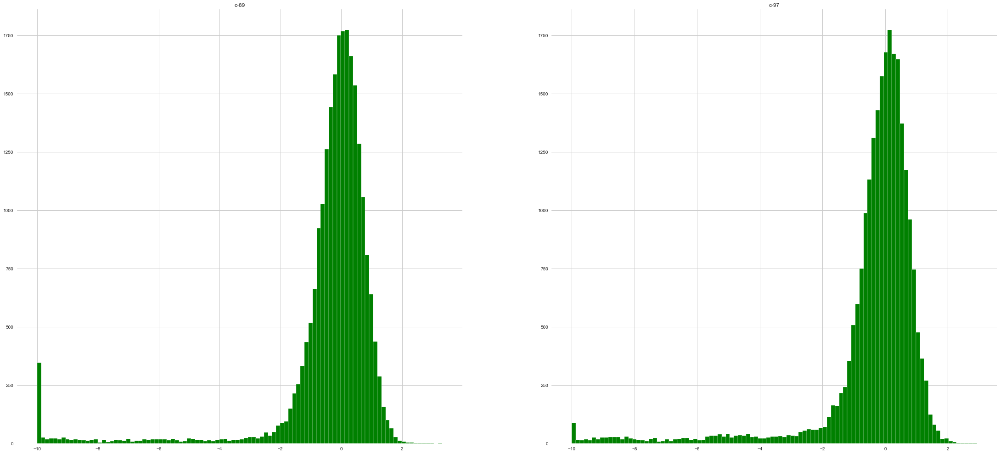

In [43]:
plt.figure(figsize=(80,80))
sns.set_style('whitegrid')
cell_choice=np.random.choice(len(CELLS),2)
for i,col in enumerate(cell_choice):
    plt.subplot(4,4,i+1)
    plt.hist(train.loc[:,CELLS[col]],bins=100,color="green")
    plt.title(CELLS[col])
plt.savefig('random celldistro.png', bbox_inches='tight')

In [44]:
def treated(a):
    treated= a[a['cp_type']=='trt_cp']
    return treated

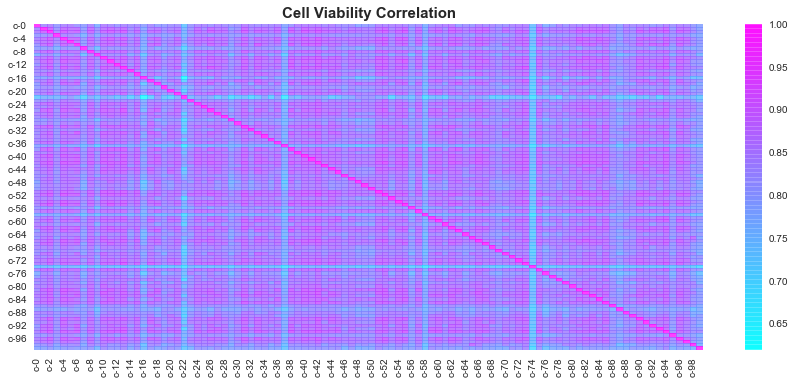

<Figure size 576x396 with 0 Axes>

In [45]:
cells = treated(train)[CELLS]
plt.figure(figsize=(15,6))
sns.heatmap(cells.corr(),cmap='cool',alpha=0.75)
plt.title('Cell Viability Correlation', fontsize=15, weight='bold')
plt.show()
# plt.savefig('Cellviab heat.png')

In [48]:
def corrs(data,col1="Cell 1",col2="Cell 2",rows=5,thresh=0.9,pos=[1,3,5,7,9,11,13,15,17,19,21,23,25,27,29,31,33,35,37,39,41,43,45,47,49,51,53]):
    #Correlation between genes
    correlation=data.corr()
    #Unstack the dataframe
    s=correlation.unstack()
    so=s.sort_values(kind='quicksort',ascending=False)
    #Create new dataframe
    so2=pd.DataFrame(so).reset_index()
    so2=so2.rename(columns={0:'correlation','level_0':col1,'level_1':col2})
    #Filter out the coef 1 correlation between the same drugs
    so2=so2[so2['correlation']!=1]
    #Drop pair duplicates
    so2=so2.reset_index()
    pos=pos
    so3=so2.drop(so2.index[pos])
    so3=so3.drop('index',axis=1)
    #Show the first 10 high correlations
    cm = sns.light_palette("green", as_cmap=True)
    s = so3.head(rows).style.background_gradient(cmap=cm)
    print(f"{len(so2[so2['correlation']>thresh])/2} {col1} Pairs Have +{thresh} Correlation.")
    return s

In [49]:
corrs(cells,'cell 1','cell 2',rows=8)

173.0 cell 1 Pairs Have +0.9 Correlation.


,cell 1,cell 2,correlation
0,c-52,c-42,0.927873
2,c-13,c-73,0.924338
4,c-13,c-26,0.924001
6,c-11,c-55,0.917963
8,c-6,c-33,0.917805
10,c-4,c-52,0.917748
12,c-63,c-38,0.917566
14,c-94,c-38,0.917296


In [67]:
genes = treated(train)[GENES]
plt.figure(figsize=(20,20))
sns.heatmap(genes.corr(),cmap='cool',alpha=0.75)
plt.title('Gene Expression Correlation', fontsize=15, weight='bold')
plt.show()
# # plt.savefig('Geneviabheat.png')

In [52]:
gene_corr = corrs(genes,'Gene 1', 'Gene 2')
gene_corr

1.0 Gene 1 Pairs Have +0.9 Correlation.


,Gene 1,Gene 2,correlation
0,g-37,g-50,0.912383
2,g-672,g-50,0.851694
4,g-37,g-489,0.850502
6,g-489,g-50,0.847806
8,g-460,g-349,0.845178


In [53]:
genes1 = treated(train)[GENES]

In [55]:
genes1corr = genes1.corr()

### Top correlated genes, we'll use these to engineer new features in the feature engineering section

In [56]:
s = genes1corr.unstack()
so = s.sort_values(kind='quicksort')

print(so[-792:-772])

g-672  g-37     0.833165
g-37   g-672    0.833165
g-672  g-121    0.837354
g-121  g-672    0.837354
g-195  g-63     0.838530
g-63   g-195    0.838530
g-123  g-744    0.839280
g-744  g-123    0.839280
g-369  g-569    0.841484
g-569  g-369    0.841484
g-349  g-460    0.845178
g-460  g-349    0.845178
g-50   g-489    0.847806
g-489  g-50     0.847806
       g-37     0.850502
g-37   g-489    0.850502
g-50   g-672    0.851694
g-672  g-50     0.851694
g-50   g-37     0.912383
g-37   g-50     0.912383
dtype: float64


In [58]:
train_targets_scored = pd.read_csv('train_targets_scored.csv')
train_targets_nonscored = pd.read_csv('train_targets_nonscored.csv')

In [59]:
target_cols_scored=[col for col in train_targets_scored.columns if col not in ['sig_id']]
target_cols_nonscored=[col for col in train_targets_nonscored.columns if col not in ['sig_id']]

### Most common classes of drugs in the dataset - have your usual suspects like cancer drugs (tubulin, nfkb, proteasome and dna inhibitors), mood alterers (serotonin and dopamine inhibitors, as well as glutamate receptor antagonists), and novel pain killers like cycloxygenase inhibitors

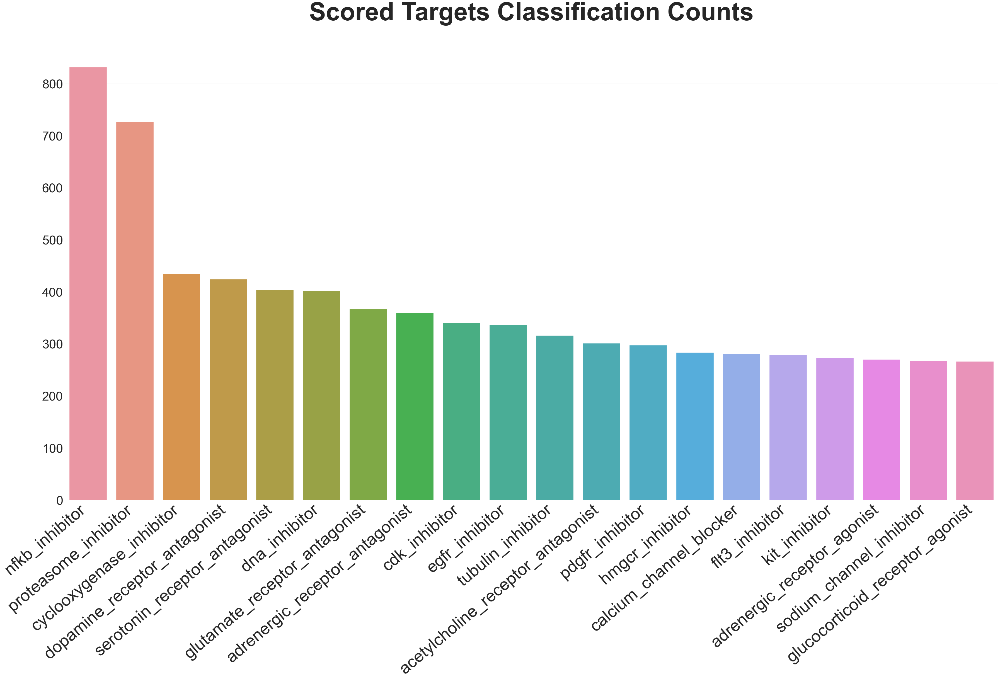

In [60]:
fig = plt.figure(figsize=(60,30))
ax = sns.barplot(y=train_targets_scored[target_cols_scored].sum(axis=0).sort_values(ascending=False).values[:20],
            x=train_targets_scored[target_cols_scored].sum(axis=0).sort_values(ascending=False).index[:20])
ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
plt.tick_params(axis='x', labelsize=60)
plt.tick_params(axis='y', labelsize=45)
plt.xlabel('')
plt.ylabel('')
plt.title('Scored Targets Classification Counts', size=90, pad=90, weight='bold')

plt.savefig('trainingsetscoredclass.png', bbox_inches='tight')
plt.show()

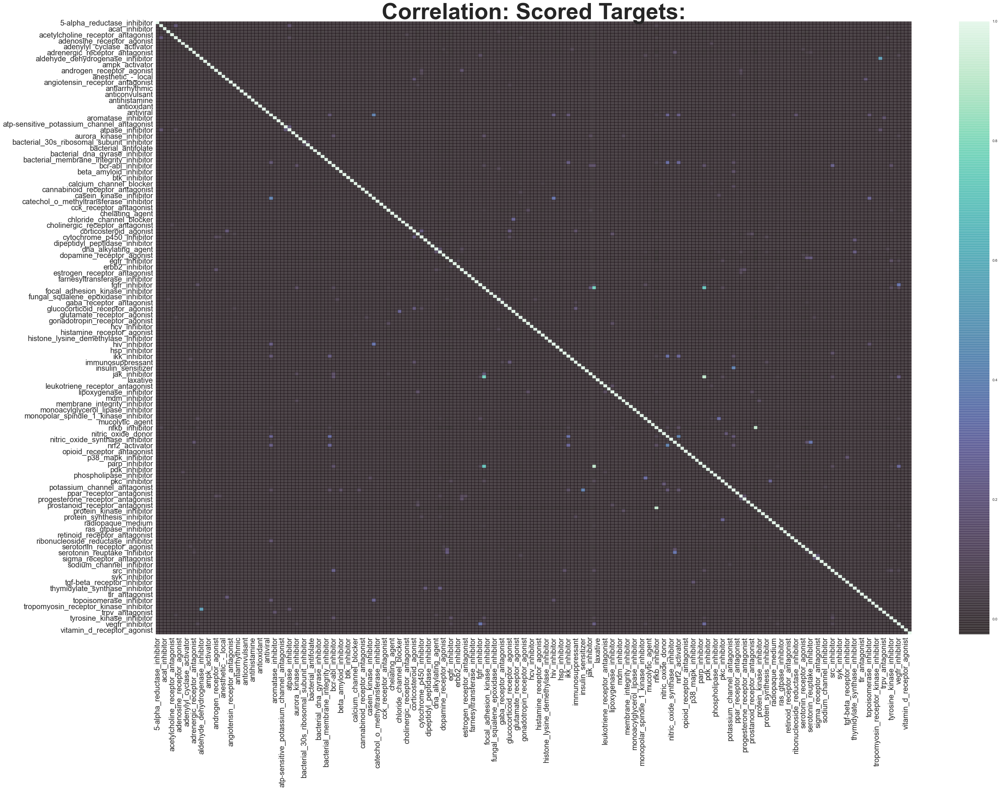

In [61]:
plt.figure(figsize=(45,30))
sns.heatmap(train_targets_scored[target_cols_scored].corr(),cmap='mako',alpha=0.75)
plt.tick_params(axis='x', labelsize=20)
plt.tick_params(axis='y', labelsize=20)
plt.title('Correlation: Scored Targets:', fontsize=60, weight='bold')
plt.savefig('corr scored.png', bbox_inches='tight')
plt.show()

In [62]:
corrs(train_targets_scored[target_cols_scored],'Target 1', 'Target 2',rows=5)

2.0 Target 1 Pairs Have +0.9 Correlation.


,Target 1,Target 2,correlation
0,proteasome_inhibitor,nfkb_inhibitor,0.921340
2,kit_inhibitor,pdgfr_inhibitor,0.915603
4,flt3_inhibitor,kit_inhibitor,0.758112
6,flt3_inhibitor,pdgfr_inhibitor,0.705119
8,trpv_agonist,aldehyde_dehydrogenase_inhibitor,0.528950


### We can also establish that drug label cacb2b860 is the control drug

In [65]:
train_drug = pd.read_csv('train_drug.csv')

In [66]:
print('First observation:')
print(f"Number of rows of the Control vehicle is {len(train[train['cp_type']=='ctl_vehicle'])}")
print(f"Number of rows of the Drug cacb2b860 is {train_drug.drug_id.value_counts()[0]}")

First observation:
Number of rows of the Control vehicle is 1866
Number of rows of the Drug cacb2b860 is 1866
